# Freesound Data Cleaning + EDA + Visualization

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline 

import IPython.display as ipd  # To play sound in the notebook
from tqdm import tqdm_notebook
import wave
from scipy.io import wavfile
SAMPLE_RATE = 44100

import seaborn as sns # for making plots with seaborn
color = sns.color_palette()
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.offline as offline
offline.init_notebook_mode()
import plotly.tools as tls
# Math
import numpy as np
from scipy.fftpack import fft
from scipy import signal
from scipy.io import wavfile
import librosa

In [2]:
import os
print(os.listdir("data"))

['audio_test', 'audio_train', 'fsd2018_extra.tgz.zip', 'sample_submission.csv', 'train.csv']


In [3]:
INPUT_LIB = 'data/'
audio_train_files = os.listdir('data/audio_train')
audio_test_files = os.listdir('data/audio_test')
train = pd.read_csv('data/train.csv')
submission = pd.read_csv("data/sample_submission.csv", index_col='fname')
train_audio_path = 'data/audio_train/'
filename = '/001ca53d.wav' # Hi-hat
sample_rate, samples = wavfile.read(str(train_audio_path) + filename)
#sample_rate = 16000

In [4]:
print(samples)

[-33 -32 -34 ...,  -1  -1  -1]


In [5]:
print("Size of training data",train.shape)

Size of training data (9473, 3)


In [6]:
train.head()

,fname,label,manually_verified
0,00044347.wav,Hi-hat,0
1,001ca53d.wav,Saxophone,1
2,002d256b.wav,Trumpet,0
3,0033e230.wav,Glockenspiel,1
4,00353774.wav,Cello,1


In [7]:
submission.head()

,label
fname,
00063640.wav,Laughter Hi-Hat Flute
0013a1db.wav,Laughter Hi-Hat Flute
002bb878.wav,Laughter Hi-Hat Flute
002d392d.wav,Laughter Hi-Hat Flute
00326aa9.wav,Laughter Hi-Hat Flute


In [8]:
def clean_filename(fname, string):   
    file_name = fname.split('/')[1]
    if file_name[:2] == '__':        
        file_name = string + file_name
    return file_name

def load_wav_file(name, path):
    _, b = wavfile.read(path + name)
    assert _ == SAMPLE_RATE
    return b

In [9]:
train_data = pd.DataFrame({'file_name' : train['fname'],
                         'target' : train['label']})   
train_data['time_series'] = train_data['file_name'].apply(load_wav_file, 
                                                      path=INPUT_LIB + 'audio_train/')    
train_data['nframes'] = train_data['time_series'].apply(len)  

In [10]:
train_data.head()

,file_name,target,time_series,nframes
0,00044347.wav,Hi-hat,"[0, 26, -5, -12, -8, -16, -30, -9, 3, 17, 67, ...",617400
1,001ca53d.wav,Saxophone,"[-33, -32, -34, -34, -37, -37, -39, -39, -41, ...",455112
2,002d256b.wav,Trumpet,"[0, 0, -2, -1, -1, -2, 0, 0, -1, -1, -1, 1, -1...",19404
3,0033e230.wav,Glockenspiel,"[0, 10, 39, -66, -49, 29, 4, -57, -133, -158, ...",352800
4,00353774.wav,Cello,"[-173, -162, -172, -142, -170, -139, -139, -13...",199332


In [11]:
print("Size of training data after some preprocessing : ",train_data.shape)

Size of training data after some preprocessing :  (9473, 4)


In [12]:
# missing data in training data set
total = train_data.isnull().sum().sort_values(ascending = False)
percent = (train_data.isnull().sum()/train_data.isnull().count()).sort_values(ascending = False)
missing_train_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_train_data.head()

,Total,Percent
nframes,0,0.0
time_series,0,0.0
target,0,0.0
file_name,0,0.0


There is no missing data in training dataset

# Manually verified Audio

In [13]:
temp = train['manually_verified'].value_counts()
labels = temp.index
sizes = (temp / temp.sum())*100
trace = go.Pie(labels=labels, values=sizes, hoverinfo='label+percent')
layout = go.Layout(title='Manually varification of labels(0 - No, 1 - Yes)')
data = [trace]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

* Approximately 40 % labels are manually verified.

C:\Users\Maxx\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning:

The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.



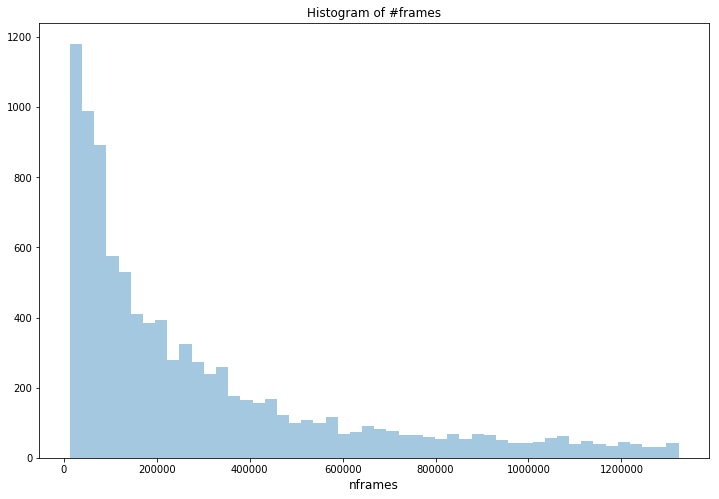

In [14]:
plt.figure(figsize=(12,8))
sns.distplot(train_data.nframes.values, bins=50, kde=False)
plt.xlabel('nframes', fontsize=12)
plt.title("Histogram of #frames")
plt.show()

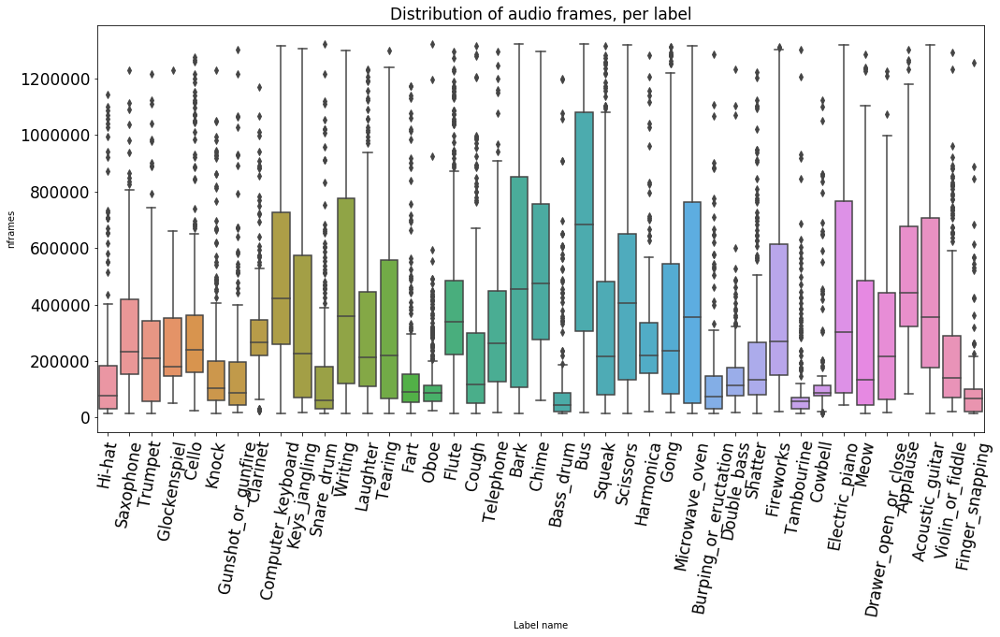

In [15]:
plt.figure(figsize=(17,8))
boxplot = sns.boxplot(x="target", y="nframes", data=train_data)
boxplot.set(xlabel='', ylabel='')
plt.title('Distribution of audio frames, per label', fontsize=17)
plt.xticks(rotation=80, fontsize=17)
plt.yticks(fontsize=17)
plt.xlabel('Label name')
plt.ylabel('nframes')
plt.show()

Total number of labels in training data :  41
Labels are :  ['Hi-hat' 'Saxophone' 'Trumpet' 'Glockenspiel' 'Cello' 'Knock'
 'Gunshot_or_gunfire' 'Clarinet' 'Computer_keyboard' 'Keys_jangling'
 'Snare_drum' 'Writing' 'Laughter' 'Tearing' 'Fart' 'Oboe' 'Flute' 'Cough'
 'Telephone' 'Bark' 'Chime' 'Bass_drum' 'Bus' 'Squeak' 'Scissors'
 'Harmonica' 'Gong' 'Microwave_oven' 'Burping_or_eructation' 'Double_bass'
 'Shatter' 'Fireworks' 'Tambourine' 'Cowbell' 'Electric_piano' 'Meow'
 'Drawer_open_or_close' 'Applause' 'Acoustic_guitar' 'Violin_or_fiddle'
 'Finger_snapping']


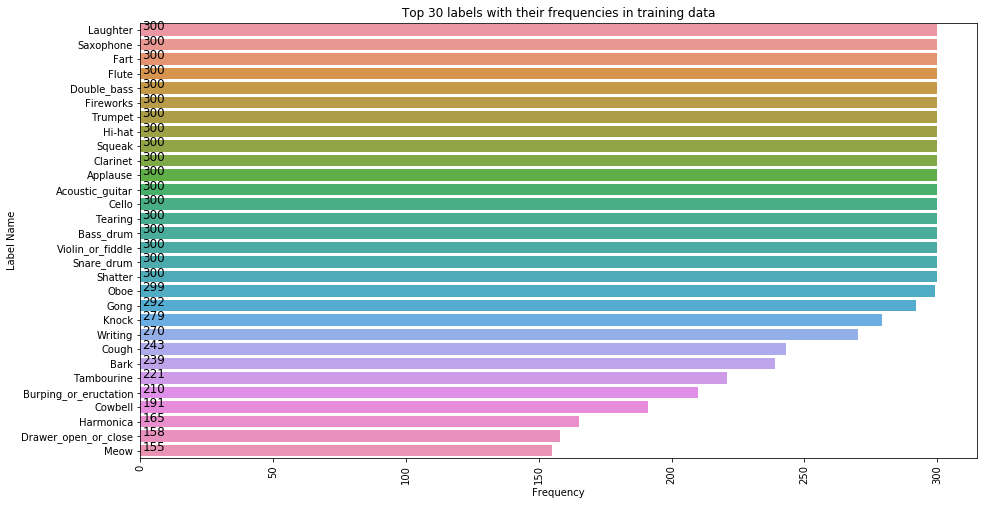

In [16]:
print("Total number of labels in training data : ",len(train_data['target'].value_counts()))
print("Labels are : ", train_data['target'].unique())
plt.figure(figsize=(15,8))
audio_type = train_data['target'].value_counts().head(30)
sns.barplot(audio_type.values, audio_type.index)
for i, v in enumerate(audio_type.values):
    plt.text(0.8,i,v,color='k',fontsize=12)
plt.xticks(rotation='vertical')
plt.xlabel('Frequency')
plt.ylabel('Label Name')
plt.title("Top 30 labels with their frequencies in training data")
plt.show()

### Total number of labels are 41

In [17]:
temp = train_data.sort_values(by='target')
temp.head()

,file_name,target,time_series,nframes
1828,3289db4d.wav,Acoustic_guitar,"[121, 119, 117, 116, 114, 111, 107, 103, 99, 9...",1275372
5240,8dfd2855.wav,Acoustic_guitar,"[1, -2, -3, -2, -1, 1, 0, 0, -1, -1, -1, 0, 0,...",707364
3254,578874df.wav,Acoustic_guitar,"[45, 66, 71, 69, 64, 72, 80, 88, 88, 85, 85, 8...",1170414
2473,43a920c9.wav,Acoustic_guitar,"[78, 81, 85, 83, 80, 79, 71, 67, 68, 65, 64, 6...",934038
303,08a68ba1.wav,Acoustic_guitar,"[9, 29, 30, -25, -68, -66, -63, -94, -94, -71,...",16758


## Now look at  some labels waveform :
  1. Acoustic_guitar
  2. Applause
  3. Bark

## 1. Acoustic_guitar

Acoustic_guitar : 


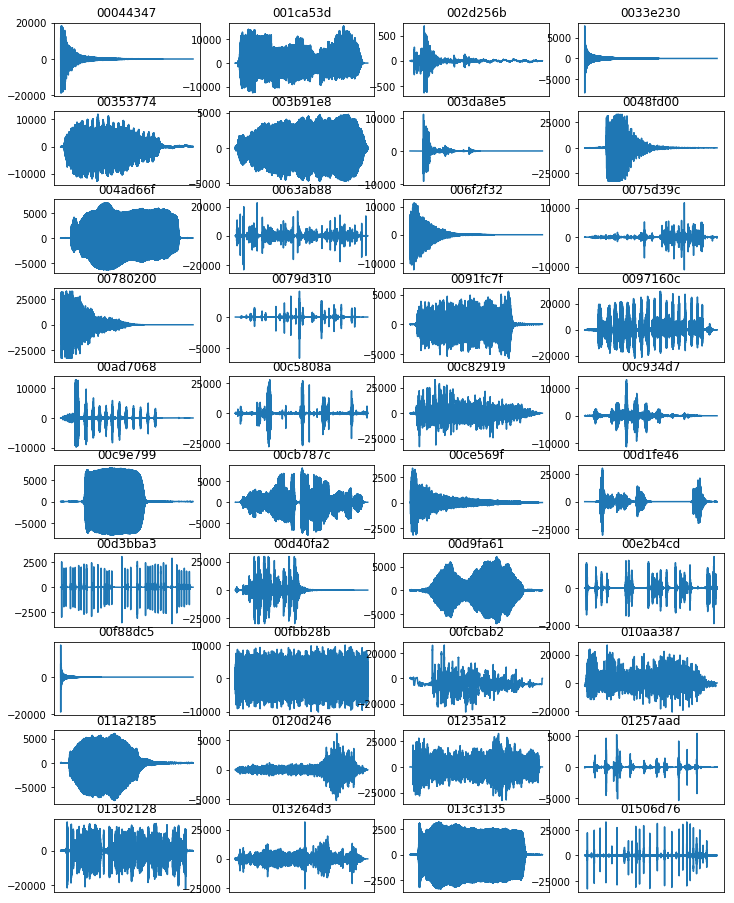

In [18]:
print("Acoustic_guitar : ")
fig, ax = plt.subplots(10, 4, figsize = (12, 16))
for i in range(40):
    ax[i//4, i%4].plot(temp['time_series'][i])
    ax[i//4, i%4].set_title(temp['file_name'][i][:-4])
    ax[i//4, i%4].get_xaxis().set_ticks([])
fig.savefig("AudioWaveform", dpi=900)     

## 2. Applause

Applause : 


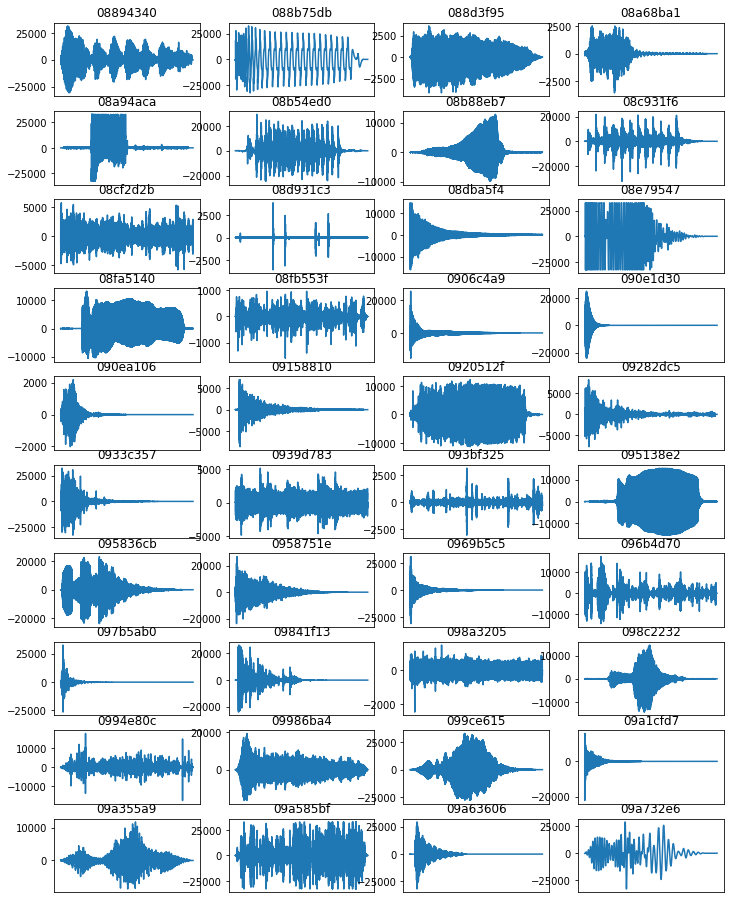

In [19]:
print("Applause : ")
fig, ax = plt.subplots(10, 4, figsize = (12, 16))
for i in range(40):
    ax[i//4, i%4].plot(temp['time_series'][i+300])
    ax[i//4, i%4].set_title(temp['file_name'][i+300][:-4])
    ax[i//4, i%4].get_xaxis().set_ticks([])

## 3. Bark

Bark : 


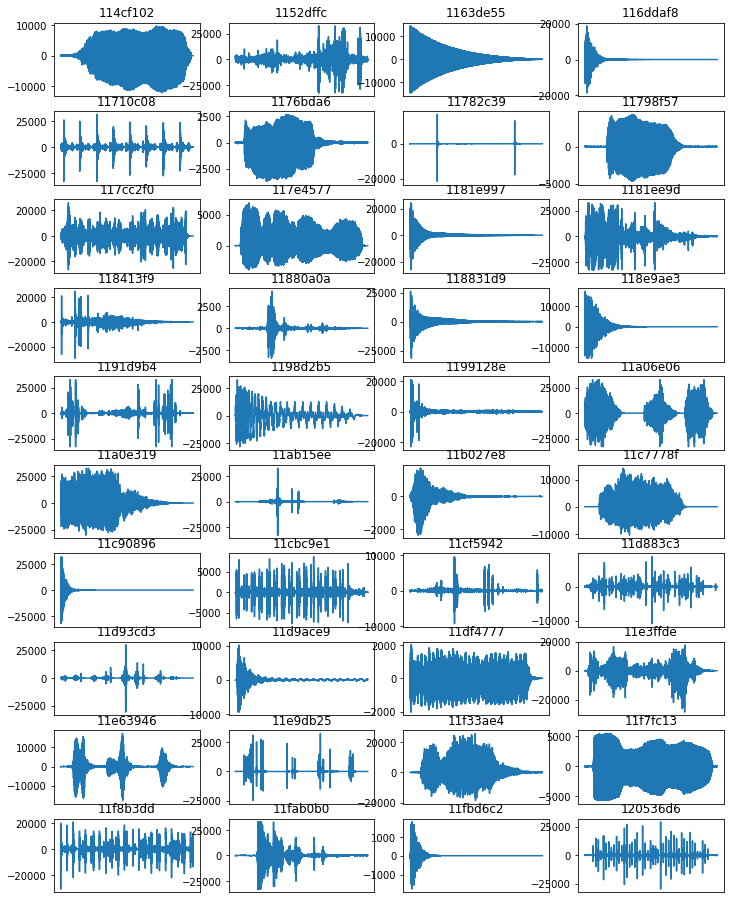

In [20]:
print("Bark : ")
fig, ax = plt.subplots(10, 4, figsize = (12, 16))
for i in range(40):
    ax[i//4, i%4].plot(temp['time_series'][i+600])
    ax[i//4, i%4].set_title(temp['file_name'][i+600][:-4])
    ax[i//4, i%4].get_xaxis().set_ticks([])

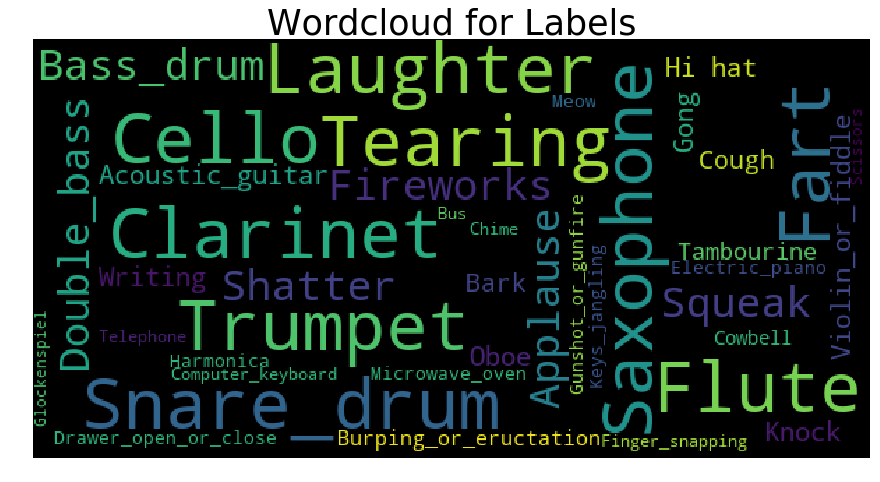

In [21]:
from wordcloud import WordCloud
wordcloud = WordCloud(max_font_size=50, width=600, height=300).generate(' '.join(train_data.target))
plt.figure(figsize=(15,8))
plt.imshow(wordcloud)
plt.title("Wordcloud for Labels", fontsize=35)
plt.axis("off")
plt.show() 
#fig.savefig("LabelsWordCloud", dpi=900)

# Spectrogram

In [22]:
def log_specgram(audio, sample_rate, window_size=20,
                 step_size=10, eps=1e-10):
    nperseg = int(round(window_size * sample_rate / 1e3))
    noverlap = int(round(step_size * sample_rate / 1e3))
    freqs, times, spec = signal.spectrogram(audio,
                                    fs=sample_rate,
                                    window='hann',
                                    nperseg=nperseg,
                                    noverlap=noverlap,
                                    detrend=False)
    return freqs, times, np.log(spec.T.astype(np.float32) + eps)

Text(0.5,0,'Seconds')

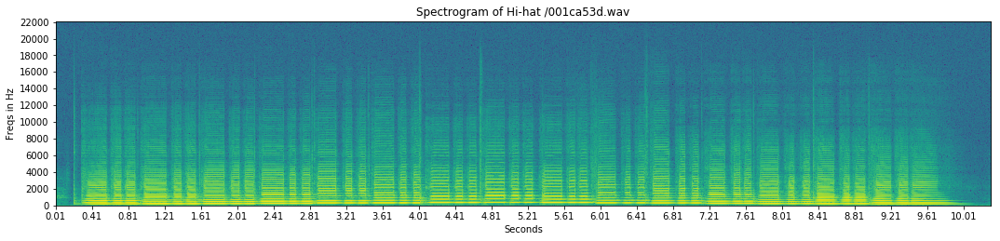

In [23]:
freqs, times, spectrogram = log_specgram(samples, sample_rate)

fig = plt.figure(figsize=(18, 8))
ax2 = fig.add_subplot(211)
ax2.imshow(spectrogram.T, aspect='auto', origin='lower', 
           extent=[times.min(), times.max(), freqs.min(), freqs.max()])
ax2.set_yticks(freqs[::40])
ax2.set_xticks(times[::40])
ax2.set_title('Spectrogram of Hi-hat ' + filename)
ax2.set_ylabel('Freqs in Hz')
ax2.set_xlabel('Seconds')

# Spectrogram of "Hi-Hat" in 3d

If we use spectrogram as an input features for NN, we have to remember to normalize features.

In [24]:
mean = np.mean(spectrogram, axis=0)
std = np.std(spectrogram, axis=0)
spectrogram = (spectrogram - mean) / std

In [27]:
data = [go.Surface(z=spectrogram.T)]
layout = go.Layout(
    title='Spectrogram of "Hi-Hat" in 3d',
    scene = dict(
    yaxis = dict(title='Frequencies', range=freqs),
    xaxis = dict(title='Time', range=times),
    zaxis = dict(title='Log amplitude'),
    ),
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)